In [ ]:
import warnings

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import scarf
import seaborn as sns

warnings.filterwarnings("ignore")

In [ ]:
isg_mapped = pd.read_csv("../files/interferon-signature-gene-ensemble-mapped.txt", sep="\t")
isg_mapped = isg_mapped.rename(columns={"From": "entrez", "To": "ensembl"})
isg_mapped.head()

,entrez,ensembl,Species,Gene Name
0,9246,ENSG00000156587,Homo sapiens,ubiquitin conjugating enzyme E2 L6(UBE2L6)
1,7188,ENSG00000082512,Homo sapiens,TNF receptor associated factor 5(TRAF5)
2,6772,ENSG00000115415,Homo sapiens,signal transducer and activator of transcripti...
3,23586,ENSG00000107201,Homo sapiens,RNA sensor RIG-I(RIGI)
4,2766,ENSG00000137198,Homo sapiens,guanosine monophosphate reductase(GMPR)


In [2]:
ds = scarf.DataStore("../processed", default_assay="RNA")
ds

DataStore has 148342 (166016) cells with 2 assays: ASSAY2 RNA
   Cell metadata:
            'I', 'ids', 'names', 'ASSAY2_nCounts', 'ASSAY2_nFeatures', 
            'I__B_Cells', 'I__CD4_Activated_T', 'I__CD8_Cytotoxic', 'I__CD8_Cytotoxic_CTRL', 'I__CD8_Cytotoxic_EOPE', 
            'I__CD8_Cytotoxic_LOPE', 'I__CD8_Memory_T', 'I__CD8_T', 'I__CTRL', 'I__Classical_Monocytes', 
            'I__Cycling_T', 'I__EOPE', 'I__Erythrocytes', 'I__LOPE', 'I__Macrophages', 
            'I__Macrophages_CTRL', 'I__Macrophages_EOPE', 'I__Macrophages_LOPE', 'I__Monocytes', 'I__Monocytes_CTRL', 
            'I__Monocytes_EOPE', 'I__Monocytes_LOPE', 'I__Myeloid', 'I__Myeloid_CTRL', 'I__Myeloid_EOPE', 
            'I__Myeloid_LOPE', 'I__NK', 'I__NK_CTRL', 'I__NK_EOPE', 'I__NK_LOPE', 
            'I__Naive_T', 'I__Neutrophils', 'I__Plasma', 'I__Plasma_CTRL', 'I__Plasma_EOPE', 
            'I__Plasma_LOPE', 'I__Plasmacytoid', 'I__Plasmacytoid_CTRL', 'I__Plasmacytoid_EOPE', 'I__Plasmacytoid_LOPE', 
          

In [118]:
cells_df = ds.cells.to_pandas_dataframe(columns=ds.cells.columns)
feats_df = ds.RNA.feats.to_pandas_dataframe(columns=ds.RNA.feats.columns)
cells_df.shape, feats_df.shape

((166016, 35), (36601, 9))

In [5]:
cells_df.head()

,I,ids,names,ASSAY2_nCounts,ASSAY2_nFeatures,I__CTRL,I__EOPE,I__LOPE,RNA_CTRL_EOPE_pseudotime,RNA_UMAP1,...,RNA_nCounts,RNA_nFeatures,RNA_percentMito,RNA_percentRibo,RNA_pseudotime,condition,pc1,sample_id,updated_mapping,updated_mapping_cluster
0,True,AAACCCAAGTCGTTAC-1,AAACCCAAGTCGTTAC-1,2722.0,4.0,False,False,True,0.537850,-27.600227,...,5755.0,1947.0,5.647263,21.946134,0.951446,LOPE,7.461550,PPPE.207,Fibroblasts/Stellate,Unknown
1,True,AAACCCACAACAGAGC-1,AAACCCACAACAGAGC-1,1649.0,4.0,False,False,True,0.703256,6.801927,...,7618.0,2397.0,0.695721,36.505645,0.013157,LOPE,-3.652831,PPPE.207,Activated T Cells,CD4 T cells
2,True,AAACCCACAGACAAAT-1,AAACCCACAGACAAAT-1,3037.0,4.0,False,False,True,0.554409,-24.697416,...,8452.0,2535.0,4.117369,21.142925,0.946592,LOPE,0.446595,PPPE.207,Fibroblasts/Stellate,Unknown
3,True,AAACCCACAGACCAAG-1,AAACCCACAGACCAAG-1,3904.0,5.0,False,False,True,0.415315,8.243846,...,9556.0,2866.0,4.782336,19.233989,0.996702,LOPE,13.949029,PPPE.207,Mucosal Epithelial,Non-classical monocytes
4,True,AAACCCAGTCTACAAC-1,AAACCCAGTCTACAAC-1,4096.0,4.0,False,False,True,0.546862,-24.062187,...,13669.0,3920.0,2.253274,20.294096,0.946217,LOPE,3.551857,PPPE.207,Macrophages/DCs,Unknown


In [6]:
feats_df.head()

,I,ids,names,I__RNA_pseudotime__p,I__RNA_pseudotime__r,I__hvgs,dropOuts,nCells,pseudotime_clusters
0,False,ENSG00000243485,MIR1302-2HG,NaN,NaN,False,166014,2,-1
1,False,ENSG00000237613,FAM138A,NaN,NaN,False,166016,0,-1
2,False,ENSG00000186092,OR4F5,NaN,NaN,False,166016,0,-1
3,True,ENSG00000238009,AL627309.1,3.194331e-39,0.034009,False,165324,692,-1
4,False,ENSG00000239945,AL627309.3,NaN,NaN,False,165999,17,-1


In [7]:
selected_genes = feats_df[feats_df["ids"].isin(isg_mapped["ensembl"])]
# GIP2 (856781;YER054C) and GIP3 (855967;YPL137C) are not in the features
selected_genes_names = selected_genes["names"].values
selected_genes_idx = selected_genes.index.values
selected_genes.shape
# All selected 38 genes are marked HVGs

(38, 9)

In [8]:
selected_genes_idx

array([   42,  1353,  1354,  1432,  2916,  3493,  3494,  3840,  5331,
        5737,  7025,  7692,  8086,  8510,  9704, 11381, 11768, 14365,
       16090, 16416, 16758, 18372, 18376, 18927, 19130, 19716, 21844,
       22527, 22529, 22530, 23988, 25503, 25724, 26218, 31553, 33809,
       34225, 34226])

In [9]:
selected_genes[selected_genes["I__hvgs"]]

,I,ids,names,I__RNA_pseudotime__p,I__RNA_pseudotime__r,I__hvgs,dropOuts,nCells,pseudotime_clusters
18927,True,ENSG00000142089,IFITM3,0.0,0.46478,True,105395,60621,17


In [10]:
selected_genes.iloc[13]

I                                  True
ids                     ENSG00000169245
names                            CXCL10
I__RNA_pseudotime__p                0.0
I__RNA_pseudotime__r           0.044595
I__hvgs                           False
dropOuts                         164738
nCells                             1278
pseudotime_clusters                  15
Name: 8510, dtype: object

In [11]:
selected_genes_names

array(['TNFRSF18', 'IFI44L', 'IFI44', 'GBP1', 'TRAF5', 'CMPK2', 'RSAD2',
       'EIF2AK2', 'STAT1', 'SP110', 'PARP14', 'RTP4', 'LAP3', 'CXCL10',
       'NUP155', 'GMPR', 'PSMB9', 'PARP12', 'LY6E', 'DDX58', 'NTRK2',
       'IFIT2', 'IFIT1', 'IFITM3', 'TRIM22', 'UBE2L6', 'ITGA5', 'OAS1',
       'OAS3', 'OAS2', 'PSME2', 'CCNDBP1', 'LIPC', 'ISG20', 'BST2',
       'HELZ2', 'MX2', 'MX1'], dtype=object)

In [12]:
selected_genes_names[13], selected_genes_names[20]

('CXCL10', 'NTRK2')

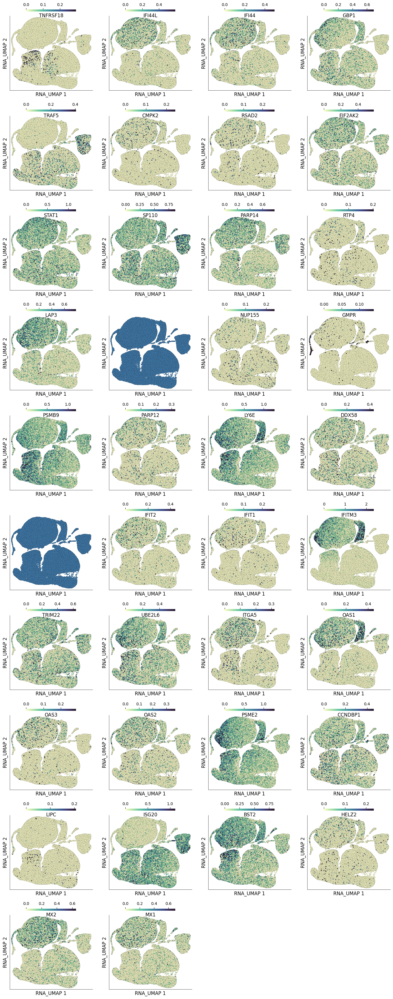

In [ ]:
ds.plot_layout(
    layout_key="RNA_UMAP",
    color_by=selected_genes_names,
    width=3.5,
    height=3.5,
    point_size=5,
)

In [ ]:
selected_cells = cells_df[cells_df["I"]].index.values
selected_cells

array([     0,      1,      2, ..., 166012, 166013, 166014])

In [72]:
selected_cells.shape

(148342,)

In [ ]:
count_data = ds.RNA.rawData
count_data_selected = count_data[selected_cells]  # [selected_genes_idx]
count_data_selected = count_data_selected[:, selected_genes_idx]
count_data_selected

dask.array<getitem, shape=(148342, 38), dtype=uint32, chunksize=(970, 3), chunktype=numpy.ndarray>

In [84]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)
pca_result = pca.fit_transform(count_data_selected)
pca_result.shape

(148342, 2)

In [86]:
pca_result_df = pd.DataFrame(pca_result, columns=["PC1", "PC2"])
pca_result_df

,PC1,PC2
0,7.503862,-5.322001
1,-2.882371,1.192463
2,0.960573,-1.845762
3,15.573251,6.711190
4,3.112675,-9.548649
...,...,...
148337,-2.614191,1.795229
148338,-2.071227,0.575688
148339,-3.262135,1.783624
148340,1.600187,-0.674141


In [87]:
pc1 = pca_result_df["PC1"].values
pc1

array([ 7.50386216, -2.88237112,  0.96057317, ..., -3.26213537,
        1.60018726, 17.64011197])

In [ ]:
ds.cells.insert(
    column_name="pc1",
    key="I",
    values=pc1,
    overwrite=True,
)

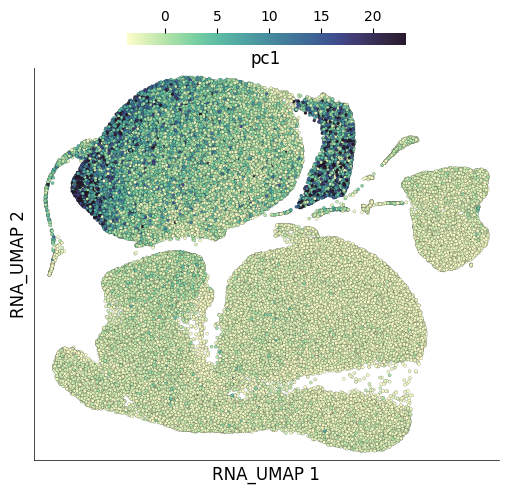

In [90]:
ds.plot_layout(
    layout_key="RNA_UMAP",
    color_by="pc1",
    # width=3.5,
    # height=3.5,
    point_size=5,
)

In [91]:
subset_cell_key_lope = (cells_df["condition"] == "CTRL").values
ds.cells.insert(
    column_name="I__CTRL",
    values=subset_cell_key_lope,
    overwrite=True,
)

In [92]:
ds.cells.head()

,I,ids,names,ASSAY2_nCounts,ASSAY2_nFeatures,I__CTRL,I__EOPE,I__LOPE,I__Macrophages,I__Macrophages_CTRL,...,RNA_nFeatures,RNA_percentMito,RNA_percentRibo,RNA_pseudotime,condition,pc1,sample_id,updated_mapping,updated_mapping_cluster,updated_mapping_cluster_grok
0,True,AAACCCAAGTCGTTAC-1,AAACCCAAGTCGTTAC-1,2722.0,4.0,False,False,True,False,False,...,1947.0,5.647263,21.946134,0.951446,LOPE,7.503862,PPPE.207,Fibroblasts/Stellate,Unknown,Monocytes
1,True,AAACCCACAACAGAGC-1,AAACCCACAACAGAGC-1,1649.0,4.0,False,False,True,False,False,...,2397.0,0.695721,36.505645,0.013157,LOPE,-2.882371,PPPE.207,Activated T Cells,CD4 T cells,CD4+ Activated T Cells
2,True,AAACCCACAGACAAAT-1,AAACCCACAGACAAAT-1,3037.0,4.0,False,False,True,False,False,...,2535.0,4.117369,21.142925,0.946592,LOPE,0.960573,PPPE.207,Fibroblasts/Stellate,Unknown,Monocytes
3,True,AAACCCACAGACCAAG-1,AAACCCACAGACCAAG-1,3904.0,5.0,False,False,True,False,False,...,2866.0,4.782336,19.233989,0.996702,LOPE,15.573251,PPPE.207,Mucosal Epithelial,Non-classical monocytes,Plasma Cells
4,True,AAACCCAGTCTACAAC-1,AAACCCAGTCTACAAC-1,4096.0,4.0,False,False,True,True,False,...,3920.0,2.253274,20.294096,0.946217,LOPE,3.112675,PPPE.207,Macrophages/DCs,Unknown,Macrophages


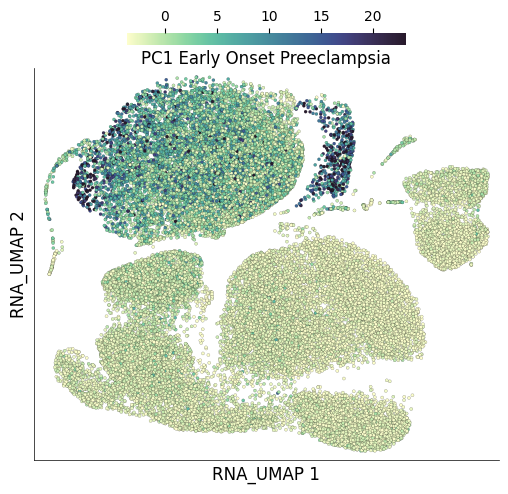

In [96]:
ds.plot_layout(
    layout_key="RNA_UMAP",
    color_by="pc1",
    subselection_key="I__EOPE",
    point_size=5,
    title="PC1 Early Onset Preeclampsia",
)

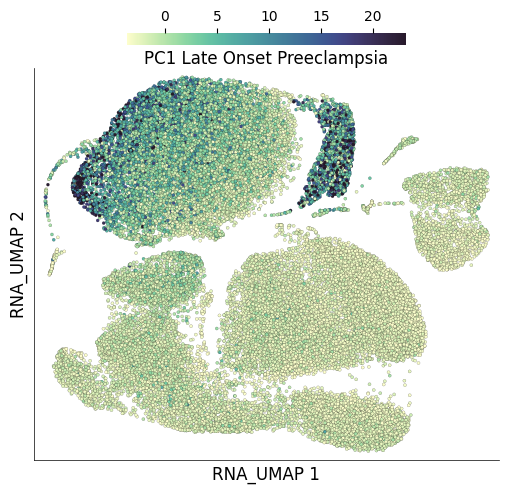

In [97]:
ds.plot_layout(
    layout_key="RNA_UMAP",
    color_by="pc1",
    subselection_key="I__LOPE",
    point_size=5,
    title="PC1 Late Onset Preeclampsia",
)

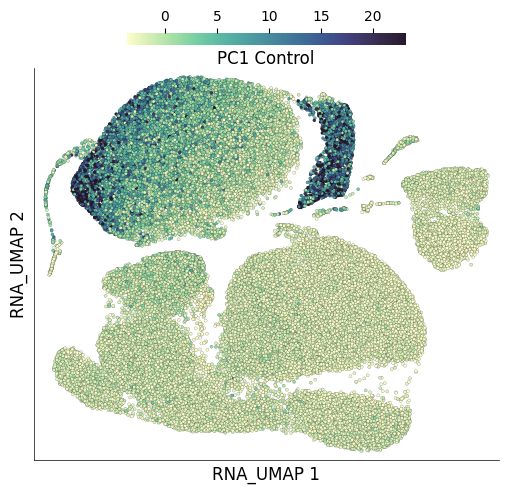

In [98]:
ds.plot_layout(
    layout_key="RNA_UMAP",
    color_by="pc1",
    subselection_key="I__CTRL",
    point_size=5,
    title="PC1 Control",
)

# IFITM3

In [5]:
def plot_marker(ds, gene, cell_keys=["I__CTRL", "I__EOPE", "I__LOPE"]) -> None:
    for cell_key in cell_keys:
        ds.plot_layout(
            layout_key="RNA_UMAP",
            color_by=gene,
            cell_key=cell_key,
            point_size=5,
            title=f"{cell_key.split('__')[1]} - {gene}",
        )
    return None

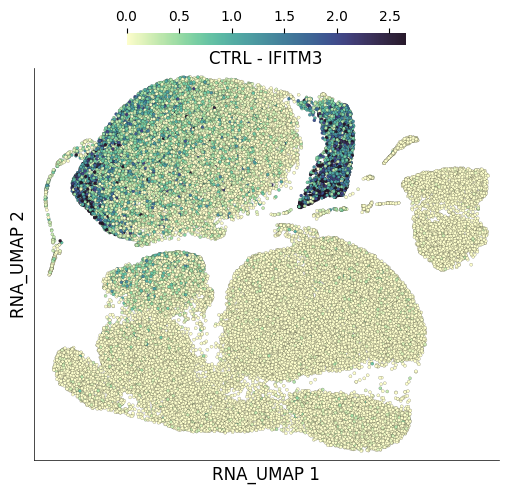

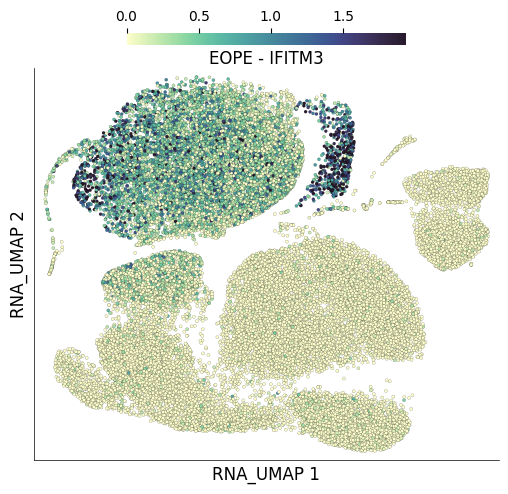

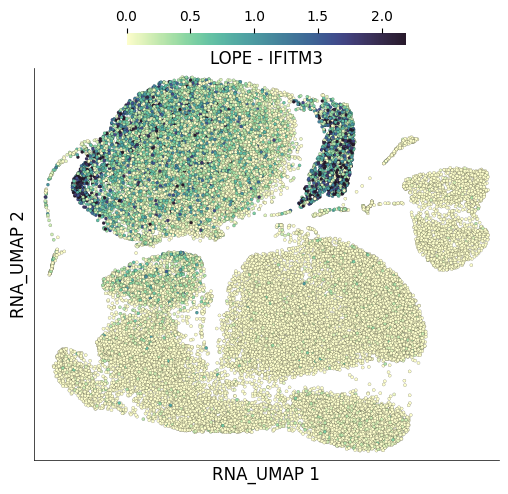

In [6]:
plot_marker(ds, "IFITM3")

# Cell Types

In [ ]:
cell_labels = pd.read_csv("../files/supp-cell-types.csv")
cell_labels["GENE NAME"] = cell_labels["GENE NAME"].str.strip()
cell_labels["DESCRIPTION"] = cell_labels["DESCRIPTION"].str.strip()
cell_labels["CELL CLUSTER"] = cell_labels["CELL CLUSTER"].str.strip()
cell_labels

,GENE NAME,DESCRIPTION,CELL CLUSTER
0,CD14,Cluster of Differentiation 14,Monocytes and Mono-NK
1,PADI2,Peptidyl arginine deiminase 2,Classical monocytes
2,ST6GALNAC3,"ST6 N-acetylgalactosaminide alpha-2, 6-sialylt...",Intermediate monocytes
3,HES4,Hes family BHLH transcription factor 4,Non-classical monocytes
4,CD160,Cluster of differentiation 160,NK
5,NCAM1,Neural cell adhesion molecule 1,NK
6,GZMK,Granzyme K,"NK CD56dim, CD8 T cells, and Mono-NK"
7,FCER1A,Fc fragment of IgE,Dendritic cells
8,CD1C,Cluster of Differentiation 1C,Conventional dendritic cells
9,GZMB,Granzyme B,Plasmacytoid dendritic cells


In [102]:
# isg_mapped
cell_labels["ENSEMBL"] = None
for idx, row in cell_labels.iterrows():
    gene_name = row["GENE NAME"]
    if gene_name in feats_df["names"].values:
        ensembl = feats_df[feats_df["names"] == gene_name]["ids"].values[0]
        cell_labels.at[idx, "ENSEMBL"] = ensembl
cell_labels

,GENE NAME,DESCRIPTION,CELL CLUSTER,ENSEMBL
0,CD14,Cluster of Differentiation 14,Monocytes and Mono-NK,ENSG00000170458
1,PADI2,Peptidyl arginine deiminase 2,Classical monocytes,ENSG00000117115
2,ST6GALNAC3,"ST6 N-acetylgalactosaminide alpha-2, 6-sialylt...",Intermediate monocytes,ENSG00000184005
3,HES4,Hes family BHLH transcription factor 4,Non-classical monocytes,ENSG00000188290
4,CD160,Cluster of differentiation 160,NK,ENSG00000117281
5,NCAM1,Neural cell adhesion molecule 1,NK,ENSG00000149294
6,GZMK,Granzyme K,"NK CD56dim, CD8 T cells, and Mono-NK",ENSG00000113088
7,FCER1A,Fc fragment of IgE,Dendritic cells,ENSG00000179639
8,CD1C,Cluster of Differentiation 1C,Conventional dendritic cells,ENSG00000158481
9,GZMB,Granzyme B,Plasmacytoid dendritic cells,ENSG00000100453


In [103]:
markers = ds.get_markers(group_key="RNA_leiden_cluster")
markers = markers.sort_values(["group_id", "score"], ascending=[True, False])
# for each group_id, get the top 2 markers
markers_top5 = markers.groupby("group_id").head(5)
markers_top5

,group_id,feature_name,feature_index,score,mean,mean_rest,frac_exp,frac_exp_rest,fold_change
0,1,TNFRSF4,43.0,0.48601,0.06897,0.00394,0.27190,0.01736,17.50047
1,1,AC139720.1,8983.0,0.28094,0.12380,0.03089,0.31262,0.07422,4.00816
2,1,ZC3H12D,12752.0,0.27925,0.07310,0.01123,0.28074,0.05975,6.51204
3,1,CD40LG,36240.0,0.27619,0.06394,0.01239,0.29399,0.05437,5.16279
4,1,FAAH2,35764.0,0.26145,0.11098,0.02235,0.32615,0.07164,4.96525
...,...,...,...,...,...,...,...,...,...
912,17,AL139042.1,12294.0,0.90265,1.00811,0.00177,0.66000,0.00811,568.65237
913,17,ADGRG3,27490.0,0.88113,0.37994,0.00136,0.54000,0.00639,279.05320
914,17,IL1R1,4587.0,0.87999,0.81635,0.00189,0.68000,0.01139,431.35933
915,17,CXCR1,5588.0,0.87868,0.25133,0.00084,0.44000,0.00371,298.70647


In [ ]:
markers.to_csv("../files/cluster-marker-genes.csv")

In [105]:
markers[markers["group_id"] == 2]

,group_id,feature_name,feature_index,score,mean,mean_rest,frac_exp,frac_exp_rest,fold_change
6,2,ANKRD55,9847.0,0.50660,0.07357,0.00509,0.27537,0.02509,14.46565
7,2,ADTRP,11341.0,0.47578,0.07267,0.00642,0.26931,0.03318,11.31297
8,2,TSHZ2,33625.0,0.40204,0.38479,0.04642,0.53834,0.08305,8.28880
9,2,AC139720.1,8983.0,0.35667,0.16031,0.02577,0.34931,0.07039,6.22066
10,2,LEF1-AS1,8753.0,0.34760,0.07502,0.01060,0.27758,0.04886,7.08037
11,2,CHRM3-AS2,3269.0,0.33384,0.07103,0.01169,0.29749,0.06220,6.07474
12,2,EPHX2,15064.0,0.31360,0.04735,0.00876,0.21658,0.04828,5.40859
13,2,AK5,1338.0,0.30481,0.10667,0.01896,0.35090,0.06953,5.62458
14,2,MAL,4467.0,0.29324,0.23587,0.05128,0.65247,0.17798,4.59988
15,2,LINC01891,5818.0,0.27947,0.10107,0.02048,0.32782,0.08213,4.93567


In [106]:
markers_top5[["group_id", "feature_name", "score"]].values

array([[1, 'TNFRSF4', 0.48601],
       [1, 'AC139720.1', 0.28094],
       [1, 'ZC3H12D', 0.27925],
       [1, 'CD40LG', 0.27619],
       [1, 'FAAH2', 0.26145],
       [2, 'ANKRD55', 0.5066],
       [2, 'ADTRP', 0.47578],
       [2, 'TSHZ2', 0.40204],
       [2, 'AC139720.1', 0.35667],
       [2, 'LEF1-AS1', 0.3476],
       [3, 'ADAMTS2', 0.40097],
       [3, 'MARC1', 0.36324],
       [3, 'RNASE2', 0.36162],
       [3, 'RBP7', 0.33251],
       [3, 'MGST1', 0.32341],
       [4, 'LGALS2', 0.37987],
       [4, 'PID1', 0.34004],
       [4, 'SASH1', 0.3204],
       [4, 'MARCO', 0.29379],
       [4, 'OLR1', 0.27083],
       [5, 'GZMH', 0.51576],
       [5, 'IFNG', 0.40035],
       [5, 'FCRL6', 0.38729],
       [5, 'FGFBP2', 0.3762],
       [5, 'ADGRG1', 0.35095],
       [6, 'NRCAM', 0.66836],
       [6, 'AL590006.1', 0.64515],
       [6, 'LINC02446', 0.53922],
       [6, 'LRRN3', 0.42901],
       [6, 'SNTG2', 0.391],
       [7, 'LINGO2', 0.81824],
       [7, 'BNC2', 0.79754],
       [7, 'SH2D

In [107]:
markers_top5["feature_name"].values

array(['TNFRSF4', 'AC139720.1', 'ZC3H12D', 'CD40LG', 'FAAH2', 'ANKRD55',
       'ADTRP', 'TSHZ2', 'AC139720.1', 'LEF1-AS1', 'ADAMTS2', 'MARC1',
       'RNASE2', 'RBP7', 'MGST1', 'LGALS2', 'PID1', 'SASH1', 'MARCO',
       'OLR1', 'GZMH', 'IFNG', 'FCRL6', 'FGFBP2', 'ADGRG1', 'NRCAM',
       'AL590006.1', 'LINC02446', 'LRRN3', 'SNTG2', 'LINGO2', 'BNC2',
       'SH2D1B', 'KLRF1', 'AKR1C3', 'EREG', 'FAM198B-AS1', 'SGMS2',
       'NRG1', 'TNFAIP6', 'VPREB3', 'AP002075.1', 'LINC00926',
       'LINC01857', 'CD24', 'LYPD2', 'VMO1', 'CDKN1C', 'CKB', 'LINC02345',
       'GZMK', 'CD8B', 'IFNG-AS1', 'CD8A', 'TIGIT', 'SLC4A10', 'IL23R',
       'LINC01644', 'ADAM12', 'CXCR6', 'TUBB1', 'GP9', 'TREML1', 'CMTM5',
       'PF4V1', 'CLEC4C', 'LINC01478', 'CUX2', 'LILRA4', 'SCT', 'ALAS2',
       'AHSP', 'HBM', 'CA1', 'SELENBP1', 'AL139042.1', 'ADGRG3', 'IL1R1',
       'CXCR1', 'FCGR3B'], dtype=object)

In [76]:
from collections import Counter

cluster_mapping = {}
cluster_mapping[-1] = "NaN"
for grp, data in markers.groupby("group_id"):
    # cluster_mapping[grp] = data['feature_name'].values
    group_markers = data["feature_name"].values
    group_markers_cells = []
    for marker in group_markers:
        if marker in cell_labels["GENE NAME"].values:
            group_markers_cells.append(
                cell_labels[cell_labels["GENE NAME"] == marker]["CELL CLUSTER"].values[
                    0
                ]
            )
    if len(group_markers_cells) > 0:
        # assign most common cell type
        most_common = Counter(group_markers_cells).most_common(1)[0][0]
        cluster_mapping[grp] = most_common
    else:
        cluster_mapping[grp] = "Unknown"

In [77]:
cluster_mapping

{-1: 'NaN',
 1: 'CD4 T cells',
 2: 'Unknown',
 3: 'Unknown',
 4: 'Unknown',
 5: 'Unknown',
 6: 'CD8 T cells (naive and effector)',
 7: 'NK',
 8: 'Unknown',
 9: 'B cells',
 10: 'Non-classical monocytes',
 11: 'NK CD56dim, CD8 T cells, and  Mono-NK',
 12: 'NK CD56dim, CD8 T cells, and  Mono-NK',
 13: 'Platelets',
 15: 'Plasma cells',
 16: 'Erythroid',
 17: 'Classical monocytes'}

In [ ]:
markers[markers["group_id"] == 2][["feature_name", "fold_change"]].values

array([['ANKRD55', 14.46565],
       ['ADTRP', 11.31297],
       ['TSHZ2', 8.2888],
       ['AC139720.1', 6.22066],
       ['LEF1-AS1', 7.08037],
       ['CHRM3-AS2', 6.07474],
       ['EPHX2', 5.40859],
       ['AK5', 5.62458],
       ['MAL', 4.59988],
       ['LINC01891', 4.93567],
       ['LRRN3', 4.92687],
       ['KANK1', 5.28023],
       ['TRABD2A', 4.56558],
       ['ICOS', 3.61409],
       ['CCR7', 4.94452],
       ['LEF1', 4.64238]], dtype=object)

In [78]:
cells_df = ds.cells.to_pandas_dataframe(columns=ds.cells.columns)
cells_df

,I,ids,names,ASSAY2_nCounts,ASSAY2_nFeatures,I__CTRL,I__EOPE,I__LOPE,RNA_CTRL_EOPE_pseudotime,RNA_UMAP1,...,RNA_leiden_cluster,RNA_nCounts,RNA_nFeatures,RNA_percentMito,RNA_percentRibo,RNA_pseudotime,condition,pc1,sample_id,updated_mapping
0,True,AAACCCAAGTCGTTAC-1,AAACCCAAGTCGTTAC-1,2722.0,4.0,False,False,True,0.537850,-27.600227,...,3,5755.0,1947.0,5.647263,21.946134,0.951446,LOPE,7.461550,PPPE.207,Fibroblasts/Stellate
1,True,AAACCCACAACAGAGC-1,AAACCCACAACAGAGC-1,1649.0,4.0,False,False,True,0.703256,6.801927,...,1,7618.0,2397.0,0.695721,36.505645,0.013157,LOPE,-3.652831,PPPE.207,Activated T Cells
2,True,AAACCCACAGACAAAT-1,AAACCCACAGACAAAT-1,3037.0,4.0,False,False,True,0.554409,-24.697416,...,3,8452.0,2535.0,4.117369,21.142925,0.946592,LOPE,0.446595,PPPE.207,Fibroblasts/Stellate
3,True,AAACCCACAGACCAAG-1,AAACCCACAGACCAAG-1,3904.0,5.0,False,False,True,0.415315,8.243846,...,10,9556.0,2866.0,4.782336,19.233989,0.996702,LOPE,13.949029,PPPE.207,Mucosal Epithelial
4,True,AAACCCAGTCTACAAC-1,AAACCCAGTCTACAAC-1,4096.0,4.0,False,False,True,0.546862,-24.062187,...,4,13669.0,3920.0,2.253274,20.294096,0.946217,LOPE,3.551857,PPPE.207,Macrophages/DCs
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
166011,True,TTTGTTGGTAGAGCTG-48,TTTGTTGGTAGAGCTG-48,1240.0,4.0,False,False,True,0.788822,-23.060780,...,7,3906.0,1928.0,5.427547,15.002560,0.050181,LOPE,-2.816085,PPPE.253,Neural/Epithelial
166012,True,TTTGTTGGTTCCAAAC-48,TTTGTTGGTTCCAAAC-48,1144.0,4.0,False,False,True,0.719397,12.994844,...,6,3619.0,1489.0,9.229069,25.255595,0.001728,LOPE,-4.160170,PPPE.253,Neuronal/Progenitors
166013,True,TTTGTTGTCAGACTGT-48,TTTGTTGTCAGACTGT-48,2666.0,4.0,False,False,True,0.549505,-19.441410,...,4,6027.0,2560.0,3.666833,11.033682,0.943797,LOPE,0.954828,PPPE.253,Macrophages/DCs
166014,True,TTTGTTGTCAGAGTGG-48,TTTGTTGTCAGAGTGG-48,4282.0,4.0,False,False,True,0.423465,11.615474,...,10,9914.0,3171.0,8.503127,15.352027,0.991722,LOPE,15.774904,PPPE.253,Mucosal Epithelial


In [80]:
upated_cluster_mapping = cells_df["RNA_leiden_cluster"].map(cluster_mapping).values
upated_cluster_mapping

array(['Unknown', 'CD4 T cells', 'Unknown', ..., 'Unknown',
       'Non-classical monocytes', 'NaN'], dtype=object)

In [ ]:
ds.cells.insert(
    column_name="updated_mapping_cluster", values=upated_cluster_mapping, overwrite=True
)

In [82]:
ds.cells.head()

,I,ids,names,ASSAY2_nCounts,ASSAY2_nFeatures,I__CTRL,I__EOPE,I__LOPE,RNA_CTRL_EOPE_pseudotime,RNA_UMAP1,...,RNA_nCounts,RNA_nFeatures,RNA_percentMito,RNA_percentRibo,RNA_pseudotime,condition,pc1,sample_id,updated_mapping,updated_mapping_cluster
0,True,AAACCCAAGTCGTTAC-1,AAACCCAAGTCGTTAC-1,2722.0,4.0,False,False,True,0.537850,-27.600227,...,5755.0,1947.0,5.647263,21.946134,0.951446,LOPE,7.461550,PPPE.207,Fibroblasts/Stellate,Unknown
1,True,AAACCCACAACAGAGC-1,AAACCCACAACAGAGC-1,1649.0,4.0,False,False,True,0.703256,6.801927,...,7618.0,2397.0,0.695721,36.505645,0.013157,LOPE,-3.652831,PPPE.207,Activated T Cells,CD4 T cells
2,True,AAACCCACAGACAAAT-1,AAACCCACAGACAAAT-1,3037.0,4.0,False,False,True,0.554409,-24.697416,...,8452.0,2535.0,4.117369,21.142925,0.946592,LOPE,0.446595,PPPE.207,Fibroblasts/Stellate,Unknown
3,True,AAACCCACAGACCAAG-1,AAACCCACAGACCAAG-1,3904.0,5.0,False,False,True,0.415315,8.243846,...,9556.0,2866.0,4.782336,19.233989,0.996702,LOPE,13.949029,PPPE.207,Mucosal Epithelial,Non-classical monocytes
4,True,AAACCCAGTCTACAAC-1,AAACCCAGTCTACAAC-1,4096.0,4.0,False,False,True,0.546862,-24.062187,...,13669.0,3920.0,2.253274,20.294096,0.946217,LOPE,3.551857,PPPE.207,Macrophages/DCs,Unknown


/home/gautam/miniconda3/envs/pp-scarf/lib/python3.11/site-packages/scarf/plots.py:597: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  centers = df[[x, y, vc]].groupby(vc).median().T


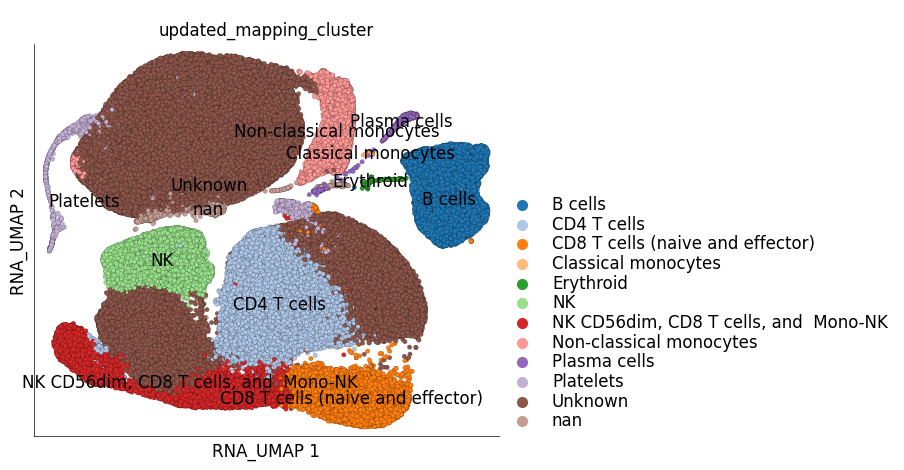

In [108]:
ds.plot_layout(layout_key="RNA_UMAP", cell_key="I", color_by="updated_mapping_cluster")

In [ ]:
# https://grok.com/share/bGVnYWN5_f04474e6-e6b4-432b-9e20-f2e6950f8f84
grok_labels = pd.read_csv("../files/grok-annotated-cell-types.csv")
grok_labels

,Group ID,Cell Type,Key Marker Genes Supporting Identification,Notes
0,1,CD4+ Activated T Cells,"TNFRSF4, CD40LG, ICOS",Strong activation markers; CD4 not in top list...
1,2,Naive T Cells,"ANKRD55, TSHZ2, CCR7, LEF1",CCR7 indicates naive/central memory; likely CD...
2,3,Monocytes,"RNASE2, CD163, S100A12, MGST1",CD163 is a classic monocyte marker; RNASE2 lin...
3,4,Macrophages,"LGALS2, MARCO, MSR1, SIGLEC1",MARCO and MSR1 suggest macrophages rather than...
4,5,CD8+ Cytotoxic T Cells,"GZMH, IFNG, CD8A, GZMA","CD8A and cytotoxic markers (GZMH, GZMA) indica..."
5,6,CD8+ Memory T Cells,"CD8B, NELL2, LEF1, CCR7",CD8B with CCR7 suggests memory CD8+ T cells
6,7,NK Cells,"LINGO2, SH2D1B, KLRF1, NKG7, GNLY",KLRF1 and NKG7 are strong NK cell markers
7,8,Myeloid Cells,"EREG, VCAN, NLRP3, IL1B",Broad myeloid signature; possibly dendritic ce...
8,9,B Cells,"VPREB3, CD24, MS4A1, CD19",CD19 and MS4A1 (CD20) are definitive B cell ma...
9,10,Plasma Cells,"IGHG1, IGHG3, JCHAIN, IGHA1",Immunoglobulin genes and JCHAIN indicate antib...


In [21]:
grok_mapping = {
    group: cell_type
    for group, cell_type in zip(grok_labels["Group ID"], grok_labels["Cell Type"])
}
grok_mapping

{1: 'CD4+ Activated T Cells',
 2: 'Naive T Cells',
 3: 'Monocytes',
 4: 'Macrophages',
 5: 'CD8+ Cytotoxic T Cells',
 6: 'CD8+ Memory T Cells',
 7: 'NK Cells',
 8: 'Myeloid Cells',
 9: 'B Cells',
 10: 'Plasma Cells',
 11: 'CD8+ T Cells',
 12: 'Plasmacytoid DCs',
 13: 'Tregs',
 14: 'Cycling T Cells',
 15: 'Classical Monocytes',
 16: 'Erythrocytes',
 17: 'Neutrophils'}

In [22]:
upated_cluster_mapping_grok = cells_df["RNA_leiden_cluster"].map(grok_mapping).values
upated_cluster_mapping_grok

array(['Monocytes', 'CD4+ Activated T Cells', 'Monocytes', ...,
       'Macrophages', 'Plasma Cells', nan], dtype=object)

In [ ]:
ds.cells.insert(
    column_name="updated_mapping_cluster_grok",
    values=upated_cluster_mapping_grok,
    overwrite=True,
)

/home/gautam/miniconda3/envs/pp-scarf/lib/python3.11/site-packages/scarf/plots.py:597: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  centers = df[[x, y, vc]].groupby(vc).median().T


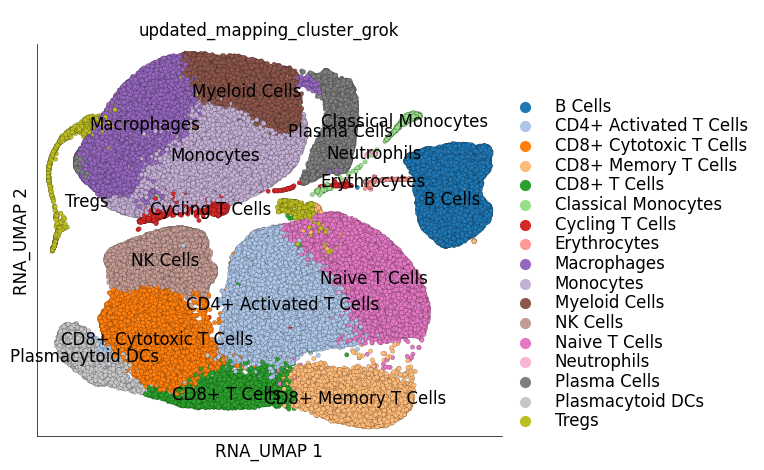

In [ ]:
ds.plot_layout(
    layout_key="RNA_UMAP", cell_key="I", color_by="updated_mapping_cluster_grok"
)

In [ ]:
selected_cells = ["Macrophages", "Myeloid Cells", "Plasma Cells"]
selected_cells

['Macrophages', 'Myeloid Cells', 'Plasma Cells']

In [166]:
grok_mapping.values()

dict_values(['CD4+ Activated T Cells', 'Naive T Cells', 'Monocytes', 'Macrophages', 'CD8+ Cytotoxic T Cells', 'CD8+ Memory T Cells', 'NK Cells', 'Myeloid Cells', 'B Cells', 'Plasma Cells', 'CD8+ T Cells', 'Plasmacytoid DCs', 'Tregs', 'Cycling T Cells', 'Classical Monocytes', 'Erythrocytes', 'Neutrophils'])

In [167]:
# Monocytes, NK Cells, CD8+ Cytotoxic T Cells, Plasmacytoid DCs

In [ ]:
cells_df = ds.cells.to_pandas_dataframe(columns=ds.cells.columns)
subset_macrophages = (cells_df["updated_mapping_cluster_grok"] == "Macrophages").values
subset_myeloid = (cells_df["updated_mapping_cluster_grok"] == "Myeloid Cells").values
subset_plasma = (cells_df["updated_mapping_cluster_grok"] == "Plasma Cells").values
subset_monocytes = (cells_df["updated_mapping_cluster_grok"] == "Monocytes").values
subset_cd8_cytotoxic = (
    cells_df["updated_mapping_cluster_grok"] == "CD8+ Cytotoxic T Cells"
).values
subset_nk = (cells_df["updated_mapping_cluster_grok"] == "NK Cells").values
subset_plasmacytoid = (
    cells_df["updated_mapping_cluster_grok"] == "Plasmacytoid DCs"
).values

In [ ]:
ds.cells.insert(
    column_name="I__Macrophages",
    values=subset_macrophages,
    overwrite=True,
)
ds.cells.insert(
    column_name="I__Myeloid",
    values=subset_myeloid,
    overwrite=True,
)
ds.cells.insert(
    column_name="I__Plasma",
    values=subset_plasma,
    overwrite=True,
)
ds.cells.insert(
    column_name="I__Monocytes",
    values=subset_monocytes,
    overwrite=True,
)
ds.cells.insert(
    column_name="I__CD8_Cytotoxic",
    values=subset_cd8_cytotoxic,
    overwrite=True,
)
ds.cells.insert(
    column_name="I__NK",
    values=subset_nk,
    overwrite=True,
)
ds.cells.insert(
    column_name="I__Plasmacytoid",
    values=subset_plasmacytoid,
    overwrite=True,
)

In [ ]:
subset_macrophages_ctrl = subset_macrophages & cells_df["I__CTRL"].values
subset_myeloid_ctrl = subset_myeloid & cells_df["I__CTRL"].values
subset_plasma_ctrl = subset_plasma & cells_df["I__CTRL"].values
subset_monocytes_ctrl = subset_monocytes & cells_df["I__CTRL"].values
subset_cd8_cytotoxic_ctrl = subset_cd8_cytotoxic & cells_df["I__CTRL"].values
subset_nk_ctrl = subset_nk & cells_df["I__CTRL"].values
subset_plasmacytoid_ctrl = subset_plasmacytoid & cells_df["I__CTRL"].values


subset_macrophages_eope = subset_macrophages & cells_df["I__EOPE"].values
subset_myeloid_eope = subset_myeloid & cells_df["I__EOPE"].values
subset_plasma_eope = subset_plasma & cells_df["I__EOPE"].values
subset_monocytes_eope = subset_monocytes & cells_df["I__EOPE"].values
subset_cd8_cytotoxic_eope = subset_cd8_cytotoxic & cells_df["I__EOPE"].values
subset_nk_eope = subset_nk & cells_df["I__EOPE"].values
subset_plasmacytoid_eope = subset_plasmacytoid & cells_df["I__EOPE"].values

subset_macrophages_lope = subset_macrophages & cells_df["I__LOPE"].values
subset_myeloid_lope = subset_myeloid & cells_df["I__LOPE"].values
subset_plasma_lope = subset_plasma & cells_df["I__LOPE"].values
subset_monocytes_lope = subset_monocytes & cells_df["I__LOPE"].values
subset_cd8_cytotoxic_lope = subset_cd8_cytotoxic & cells_df["I__LOPE"].values
subset_nk_lope = subset_nk & cells_df["I__LOPE"].values
subset_plasmacytoid_lope = subset_plasmacytoid & cells_df["I__LOPE"].values

In [171]:
ds.cells.insert(
    column_name="I__Macrophages_CTRL",
    values=subset_macrophages_ctrl,
    overwrite=True,
)
ds.cells.insert(
    column_name="I__Myeloid_CTRL",
    values=subset_myeloid_ctrl,
    overwrite=True,
)
ds.cells.insert(
    column_name="I__Plasma_CTRL",
    values=subset_plasma_ctrl,
    overwrite=True,
)
ds.cells.insert(
    column_name="I__Monocytes_CTRL",
    values=subset_monocytes_ctrl,
    overwrite=True,
)
ds.cells.insert(
    column_name="I__CD8_Cytotoxic_CTRL",
    values=subset_cd8_cytotoxic_ctrl,
    overwrite=True,
)
ds.cells.insert(
    column_name="I__NK_CTRL",
    values=subset_nk_ctrl,
    overwrite=True,
)
ds.cells.insert(
    column_name="I__Plasmacytoid_CTRL",
    values=subset_plasmacytoid_ctrl,
    overwrite=True,
)

In [172]:
ds.cells.insert(
    column_name="I__Macrophages_EOPE",
    values=subset_macrophages_eope,
    overwrite=True,
)
ds.cells.insert(
    column_name="I__Myeloid_EOPE",
    values=subset_myeloid_eope,
    overwrite=True,
)
ds.cells.insert(
    column_name="I__Plasma_EOPE",
    values=subset_plasma_eope,
    overwrite=True,
)
ds.cells.insert(
    column_name="I__Monocytes_EOPE",
    values=subset_monocytes_eope,
    overwrite=True,
)
ds.cells.insert(
    column_name="I__CD8_Cytotoxic_EOPE",
    values=subset_cd8_cytotoxic_eope,
    overwrite=True,
)
ds.cells.insert(
    column_name="I__NK_EOPE",
    values=subset_nk_eope,
    overwrite=True,
)
ds.cells.insert(
    column_name="I__Plasmacytoid_EOPE",
    values=subset_plasmacytoid_eope,
    overwrite=True,
)

In [173]:
ds.cells.insert(
    column_name="I__Macrophages_LOPE",
    values=subset_macrophages_lope,
    overwrite=True,
)
ds.cells.insert(
    column_name="I__Myeloid_LOPE",
    values=subset_myeloid_lope,
    overwrite=True,
)
ds.cells.insert(
    column_name="I__Plasma_LOPE",
    values=subset_plasma_lope,
    overwrite=True,
)
ds.cells.insert(
    column_name="I__Monocytes_LOPE",
    values=subset_monocytes_lope,
    overwrite=True,
)
ds.cells.insert(
    column_name="I__CD8_Cytotoxic_LOPE",
    values=subset_cd8_cytotoxic_lope,
    overwrite=True,
)
ds.cells.insert(
    column_name="I__NK_LOPE",
    values=subset_nk_lope,
    overwrite=True,
)
ds.cells.insert(
    column_name="I__Plasmacytoid_LOPE",
    values=subset_plasmacytoid_lope,
    overwrite=True,
)

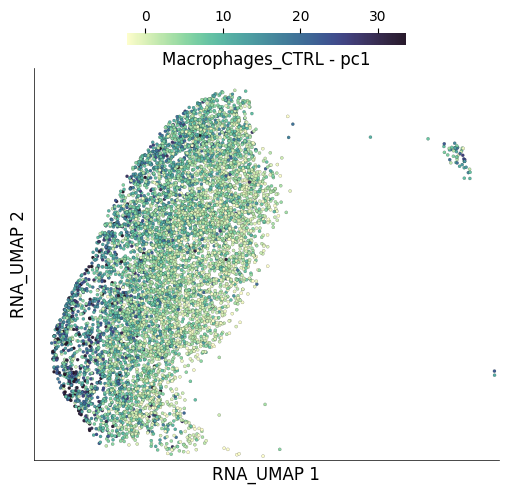

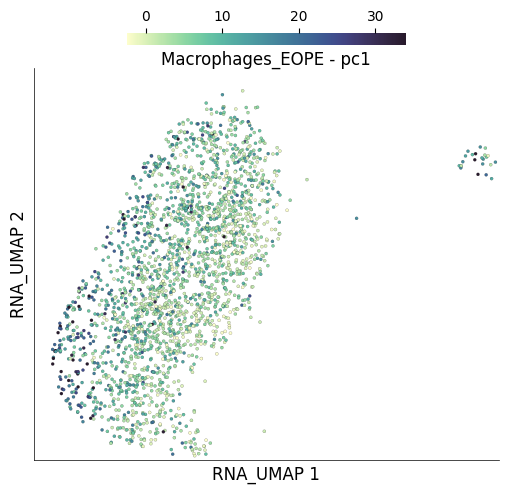

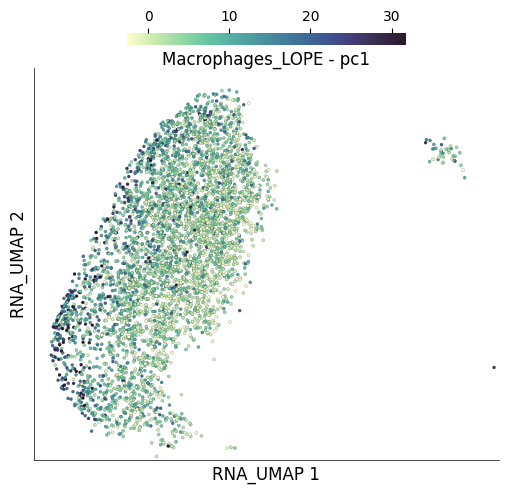

In [109]:
plot_marker(
    ds,
    "pc1",
    cell_keys=[
        "I__Macrophages_CTRL",
        # "I__Myeloid_CTRL",
        # "I__Plasma_CTRL",
        "I__Macrophages_EOPE",
        # "I__Myeloid_EOPE",
        # "I__Plasma_EOPE",
        "I__Macrophages_LOPE",
        # "I__Myeloid_LOPE",
        # "I__Plasma_LOPE",
    ],
)

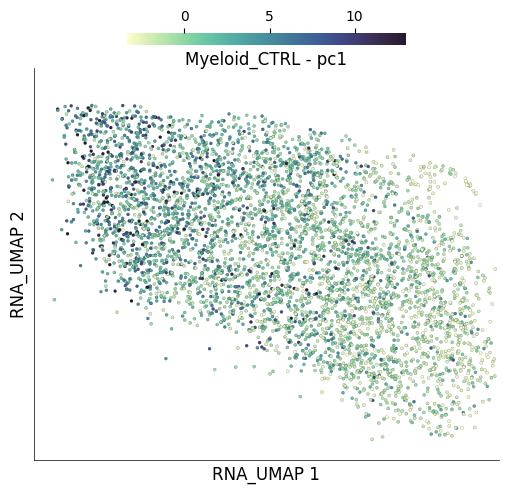

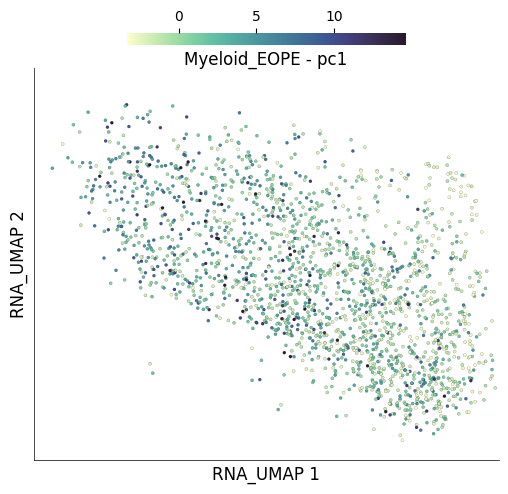

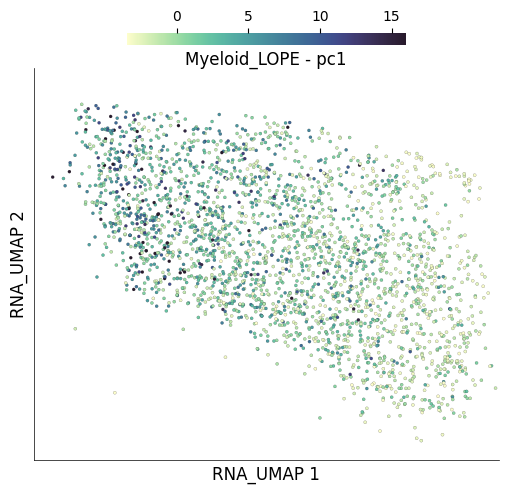

In [110]:
plot_marker(
    ds,
    "pc1",
    cell_keys=[
        # "I__Macrophages_CTRL",
        "I__Myeloid_CTRL",
        # "I__Plasma_CTRL",
        # "I__Macrophages_EOPE",
        "I__Myeloid_EOPE",
        # "I__Plasma_EOPE",
        # "I__Macrophages_LOPE",
        "I__Myeloid_LOPE",
        # "I__Plasma_LOPE",
    ],
)

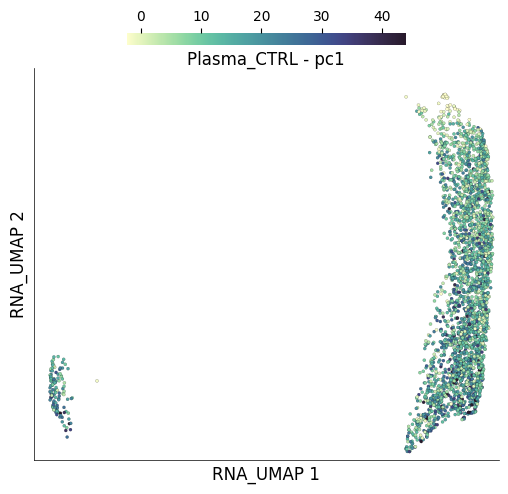

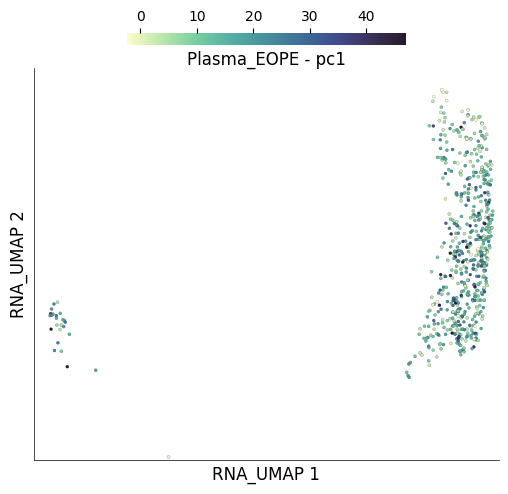

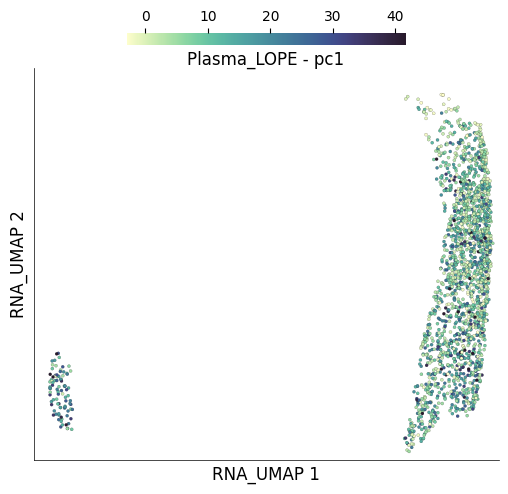

In [112]:
plot_marker(
    ds,
    "pc1",
    cell_keys=[
        # "I__Macrophages_CTRL",
        # "I__Myeloid_CTRL",
        "I__Plasma_CTRL",
        # "I__Macrophages_EOPE",
        # "I__Myeloid_EOPE",
        "I__Plasma_EOPE",
        # "I__Macrophages_LOPE",
        # "I__Myeloid_LOPE",
        "I__Plasma_LOPE",
    ],
)

In [ ]:
plot_marker(
    ds,
    "pc1",
    cell_keys=[
        "I__Monocytes_CTRL",
        "I__Monocytes_EOPE",
        "I__Monocytes_LOPE",
        "I__CD8_Cytotoxic_CTRL",
        "I__CD8_Cytotoxic_EOPE",
        "I__CD8_Cytotoxic_LOPE",
        "I__NK_CTRL",
        "I__NK_EOPE",
        "I__NK_LOPE",
        "I__Plasmacytoid_CTRL",
        "I__Plasmacytoid_EOPE",
        "I__Plasmacytoid_LOPE",
    ],
)

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

In [51]:
cells_df[subset_macrophages_ctrl]

,I,ids,names,ASSAY2_nCounts,ASSAY2_nFeatures,I__CTRL,I__EOPE,I__LOPE,RNA_CTRL_EOPE_pseudotime,RNA_UMAP1,...,RNA_nFeatures,RNA_percentMito,RNA_percentRibo,RNA_pseudotime,condition,pc1,sample_id,updated_mapping,updated_mapping_cluster,updated_mapping_cluster_grok
4346,True,AAACCCAGTGGTCTTA-2,AAACCCAGTGGTCTTA-2,3874.0,4.0,True,False,False,0.540923,-18.262390,...,3807.0,1.955004,11.605896,0.944653,CTRL,16.878241,PPPE.232,Macrophages/DCs,Unknown,Macrophages
4349,True,AAACGAACAACGACTT-2,AAACGAACAACGACTT-2,4515.0,5.0,True,False,False,0.518154,-29.775331,...,3697.0,2.261736,14.411130,0.955505,CTRL,12.348752,PPPE.232,Macrophages/DCs,Unknown,Macrophages
4363,True,AAAGGGCCATCTGTTT-2,AAAGGGCCATCTGTTT-2,4770.0,4.0,True,False,False,0.529529,-26.940550,...,3223.0,3.683074,17.756053,0.949065,CTRL,-0.205733,PPPE.232,Macrophages/DCs,Unknown,Macrophages
4370,True,AAAGTCCTCATGAGTC-2,AAAGTCCTCATGAGTC-2,2336.0,4.0,True,False,False,0.515196,-28.513853,...,1651.0,4.157044,18.966513,0.954514,CTRL,-4.147810,PPPE.232,Macrophages/DCs,Unknown,Macrophages
4373,True,AAAGTGAAGTTGCGCC-2,AAAGTGAAGTTGCGCC-2,4263.0,4.0,True,False,False,0.545483,-23.604397,...,2654.0,3.278041,16.877304,0.946127,CTRL,4.082246,PPPE.232,Macrophages/DCs,Unknown,Macrophages
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
150422,True,TTTATGCCAATTCTTC-44,TTTATGCCAATTCTTC-44,3200.0,4.0,True,False,False,0.542883,-21.615192,...,3644.0,3.082369,16.249352,0.944934,CTRL,1.010680,PPPE.233,Macrophages/DCs,Unknown,Macrophages
150439,True,TTTCCTCTCAACTCTT-44,TTTCCTCTCAACTCTT-44,2404.0,4.0,True,False,False,0.565998,-15.870984,...,2826.0,2.724134,16.280854,0.942021,CTRL,1.068937,PPPE.233,Macrophages/DCs,Unknown,Macrophages
150447,True,TTTGATCAGTGATCGG-44,TTTGATCAGTGATCGG-44,2176.0,5.0,True,False,False,0.556856,-19.852488,...,2472.0,3.772660,17.703740,0.944044,CTRL,-1.228441,PPPE.233,Macrophages/DCs,Unknown,Macrophages
150454,True,TTTGGTTGTCGGATTT-44,TTTGGTTGTCGGATTT-44,1458.0,5.0,True,False,False,0.564903,-20.169382,...,1592.0,4.687919,20.412537,0.942444,CTRL,-2.455922,PPPE.233,Macrophages/DCs,Unknown,Macrophages


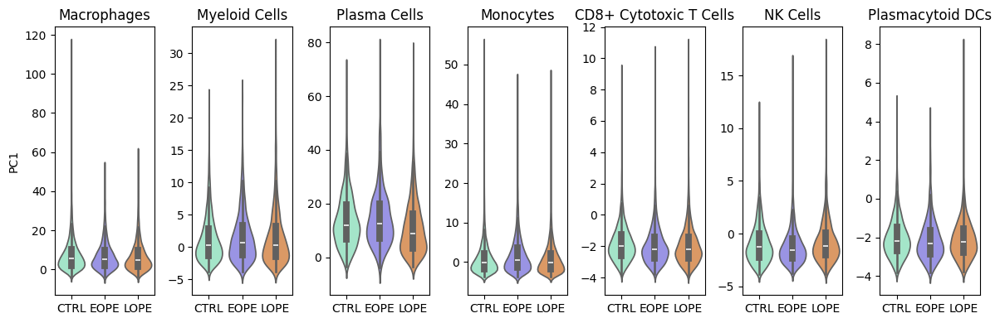

In [ ]:
macrophase = cells_df[subset_macrophages]
myeloid = cells_df[subset_myeloid]
plasma = cells_df[subset_plasma]
monocyte = cells_df[subset_monocytes]
cd8_cytotoxic = cells_df[subset_cd8_cytotoxic]
nk = cells_df[subset_nk]
plasmacytoid = cells_df[subset_plasmacytoid]

fig, ax = plt.subplots(1, 7, figsize=(12, 4))
for i, cell_type in enumerate(
    [macrophase, myeloid, plasma, monocyte, cd8_cytotoxic, nk, plasmacytoid]
):
    sns.violinplot(
        x="condition",
        y="pc1",
        data=cell_type,
        order=["CTRL", "EOPE", "LOPE"],
        palette=["#99F0CA", "#8F87F1", "#EF9651"],
        ax=ax[i],
    )
    ax[i].set_title(cell_type["updated_mapping_cluster_grok"].values[0])
    ax[i].xaxis.label.set_visible(False)
    if i == 0:
        ax[i].yaxis.set_label_text("PC1")
    else:
        ax[i].yaxis.label.set_visible(False)

# plt.suptitle("PC1")
plt.tight_layout()
plt.show()

In [ ]:
cells_df_pc_sorted = cells_df[cells_df["I"]].sort_values("pc1", ascending=False)
cells_df_pc_sorted

,I,ids,names,ASSAY2_nCounts,ASSAY2_nFeatures,I__CTRL,I__EOPE,I__LOPE,I__Macrophages,I__Macrophages_CTRL,...,RNA_nFeatures,RNA_percentMito,RNA_percentRibo,RNA_pseudotime,condition,pc1,sample_id,updated_mapping,updated_mapping_cluster,updated_mapping_cluster_grok
28763,True,GTGGTTATCTGTCGTC-9,GTGGTTATCTGTCGTC-9,4409.0,5.0,True,False,False,True,True,...,3963.0,2.624491,11.761862,0.967196,CTRL,115.289003,PPPE.194,Macrophages/DCs,Unknown,Macrophages
165022,True,TCAGCCTAGGCGATAC-48,TCAGCCTAGGCGATAC-48,5112.0,4.0,False,False,True,False,False,...,3230.0,2.271114,18.408446,0.985156,LOPE,75.592069,PPPE.253,Mucosal Epithelial,Non-classical monocytes,Plasma Cells
118207,True,TCAAGACAGCCGATTT-34,TCAAGACAGCCGATTT-34,5760.0,4.0,False,True,False,False,False,...,3316.0,2.644899,18.079418,0.995604,EOPE,75.516385,PPPE.230,Mucosal Epithelial,Non-classical monocytes,Plasma Cells
43275,True,AGGTCTAAGCAAACAT-13,AGGTCTAAGCAAACAT-13,6785.0,4.0,True,False,False,False,False,...,3993.0,2.296706,15.562275,0.987489,CTRL,69.629629,PPPE.215,Mucosal Epithelial,Non-classical monocytes,Plasma Cells
118769,True,TGGGAAGCACAGCCTG-34,TGGGAAGCACAGCCTG-34,3609.0,4.0,False,True,False,False,False,...,3482.0,2.942823,14.610156,0.997904,EOPE,65.321848,PPPE.230,Mucosal Epithelial,Non-classical monocytes,Plasma Cells
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29843,True,AAGTACCCAATTGTGC-10,AAGTACCCAATTGTGC-10,1265.0,5.0,True,False,False,False,False,...,1656.0,4.368493,33.091897,0.673254,CTRL,-3.923967,PPPE.251,Pre-B Cells,B cells,B Cells
52115,True,TCTTTGATCGATAACC-15,TCTTTGATCGATAACC-15,1046.0,4.0,False,True,False,False,False,...,1299.0,1.764371,41.462721,0.692157,EOPE,-3.944734,PPPE.199,Pre-B Cells,B cells,B Cells
75665,True,ACGGAAGTCCATTTAC-22,ACGGAAGTCCATTTAC-22,948.0,5.0,True,False,False,False,False,...,1305.0,5.495979,41.394102,0.026115,CTRL,-3.961256,PPPE.234,Activated T Cells,CD4 T cells,CD4+ Activated T Cells
39945,True,CATTCATAGTCTAACC-12,CATTCATAGTCTAACC-12,766.0,4.0,False,False,True,False,False,...,2185.0,3.589388,29.408705,0.000927,LOPE,-3.986048,PPPE.208,Neuronal/Progenitors,CD8 T cells (naive and effector),CD8+ Memory T Cells


In [ ]:
cells_df_pc_sorted[
    ["sample_id", "condition", "updated_mapping_cluster_grok", "pc1"]
].head(20)

,sample_id,condition,updated_mapping_cluster_grok,pc1
28763,PPPE.194,CTRL,Macrophages,115.289003
165022,PPPE.253,LOPE,Plasma Cells,75.592069
118207,PPPE.230,EOPE,Plasma Cells,75.516385
43275,PPPE.215,CTRL,Plasma Cells,69.629629
118769,PPPE.230,EOPE,Plasma Cells,65.321848
42808,PPPE.215,CTRL,Plasma Cells,64.904861
152054,PPPE.226,LOPE,Plasma Cells,62.763748
86527,PPPE.243,CTRL,Macrophages,62.315464
46032,PPPE.215,CTRL,Plasma Cells,61.161516
161835,PPPE.253,LOPE,Plasma Cells,59.317589


In [131]:
cells_df.columns

Index(['I', 'ids', 'names', 'ASSAY2_nCounts', 'ASSAY2_nFeatures', 'I__CTRL',
       'I__EOPE', 'I__LOPE', 'I__Macrophages', 'I__Macrophages_CTRL',
       'I__Macrophages_EOPE', 'I__Macrophages_LOPE', 'I__Myeloid',
       'I__Myeloid_CTRL', 'I__Myeloid_EOPE', 'I__Myeloid_LOPE', 'I__Plasma',
       'I__Plasma_CTRL', 'I__Plasma_EOPE', 'I__Plasma_LOPE',
       'RNA_CTRL_EOPE_pseudotime', 'RNA_UMAP1', 'RNA_UMAP2',
       'RNA_leiden_cluster', 'RNA_nCounts', 'RNA_nFeatures', 'RNA_percentMito',
       'RNA_percentRibo', 'RNA_pseudotime', 'condition', 'pc1', 'sample_id',
       'updated_mapping', 'updated_mapping_cluster',
       'updated_mapping_cluster_grok'],
      dtype='object')

# Plot

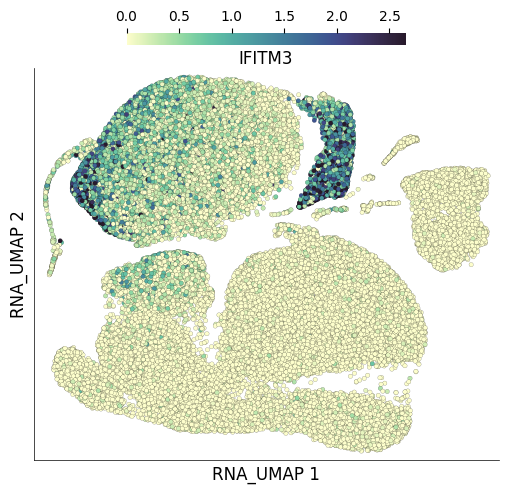

In [ ]:
ds.plot_layout(
    layout_key="RNA_UMAP",
    color_by="IFITM3",
    cell_key="I__CTRL",
    # subselection_key='I__Macrophages_CTRL'
)

In [ ]:
selected_genes_names = np.array(
    [
        "TNFRSF18",
        "IFI44L",
        "IFI44",
        "GBP1",
        "TRAF5",
        "CMPK2",
        "RSAD2",
        "EIF2AK2",
        "STAT1",
        "SP110",
        "PARP14",
        "RTP4",
        "LAP3",
        "CXCL10",
        "NUP155",
        "GMPR",
        "PSMB9",
        "PARP12",
        "LY6E",
        "DDX58",
        "NTRK2",
        "IFIT2",
        "IFIT1",
        "IFITM3",
        "TRIM22",
        "UBE2L6",
        "ITGA5",
        "OAS1",
        "OAS3",
        "OAS2",
        "PSME2",
        "CCNDBP1",
        "LIPC",
        "ISG20",
        "BST2",
        "HELZ2",
        "MX2",
        "MX1",
    ]
)
selected_genes_names

array(['TNFRSF18', 'IFI44L', 'IFI44', 'GBP1', 'TRAF5', 'CMPK2', 'RSAD2',
       'EIF2AK2', 'STAT1', 'SP110', 'PARP14', 'RTP4', 'LAP3', 'CXCL10',
       'NUP155', 'GMPR', 'PSMB9', 'PARP12', 'LY6E', 'DDX58', 'NTRK2',
       'IFIT2', 'IFIT1', 'IFITM3', 'TRIM22', 'UBE2L6', 'ITGA5', 'OAS1',
       'OAS3', 'OAS2', 'PSME2', 'CCNDBP1', 'LIPC', 'ISG20', 'BST2',
       'HELZ2', 'MX2', 'MX1'], dtype='<U8')

In [ ]:
def plot_marker_set(ds, gene, cell_keys=["I__CTRL", "I__EOPE", "I__LOPE"]) -> None:
    fig, axes = plt.subplots(
        1, len(cell_keys), figsize=(5 * len(cell_keys), 5), sharex=True, sharey=True
    )

    if len(cell_keys) == 1:
        axes = [axes]

    global_gene_vals = ds.get_cell_vals(from_assay="RNA", cell_key="I", k=gene)
    vmin = np.min(global_gene_vals)
    vmax = np.max(global_gene_vals)

    cmap = sns.cubehelix_palette(start=0.5, rot=-0.75, as_cmap=True)

    for ax, cell_key in zip(axes, cell_keys):
        # Fetch UMAP coordinates and gene expression values
        x = ds.cells.fetch("RNA_UMAP1", key=cell_key)
        y = ds.cells.fetch("RNA_UMAP2", key=cell_key)
        color_vals = ds.get_cell_vals(from_assay="RNA", cell_key=cell_key, k=gene)

        # DataFrame for Seaborn
        df = pd.DataFrame({"UMAP1": x, "UMAP2": y, "gene": color_vals})

        # Plot using Seaborn scatterplot
        sns.scatterplot(
            data=df,
            x="UMAP1",
            y="UMAP2",
            hue="gene",
            palette=cmap,
            s=5,  
            ax=ax,
            legend=False,
            vmin=vmin,
            vmax=vmax,
        )

        # Set title
        ax.set_title(f"{cell_key.split('__')[1]} - {gene}")
        ax.set_xlabel("UMAP1")
        ax.set_ylabel("UMAP2")

    # Add a single colorbar for the entire figure using the same colormap
    norm = plt.Normalize(vmin=vmin, vmax=vmax)
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)  # Changed to use same cmap
    sm.set_array([])

    # Adjust layout and display
    plt.tight_layout()
    fig.colorbar(sm, ax=axes, label=gene, shrink=0.6)
    plt.show()

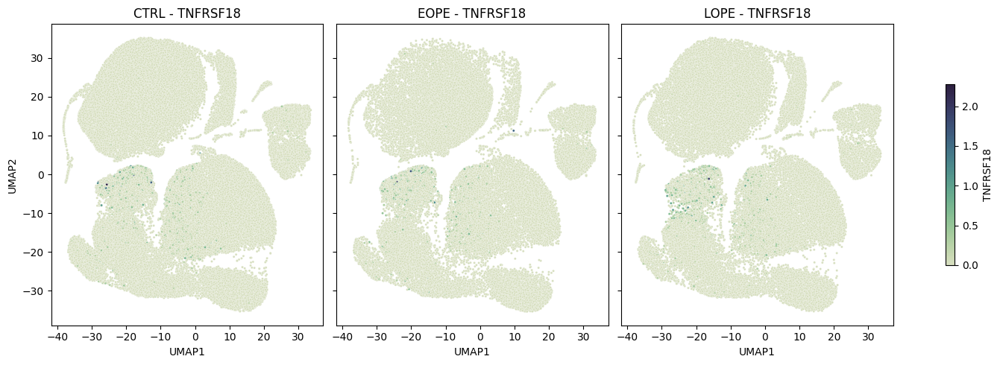

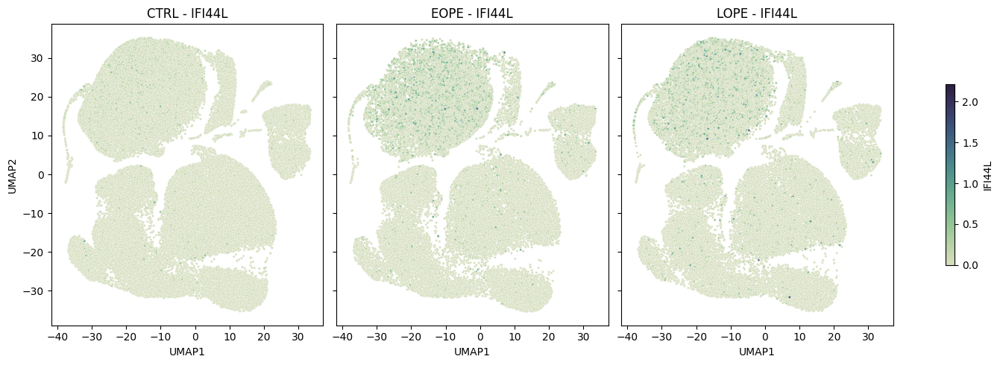

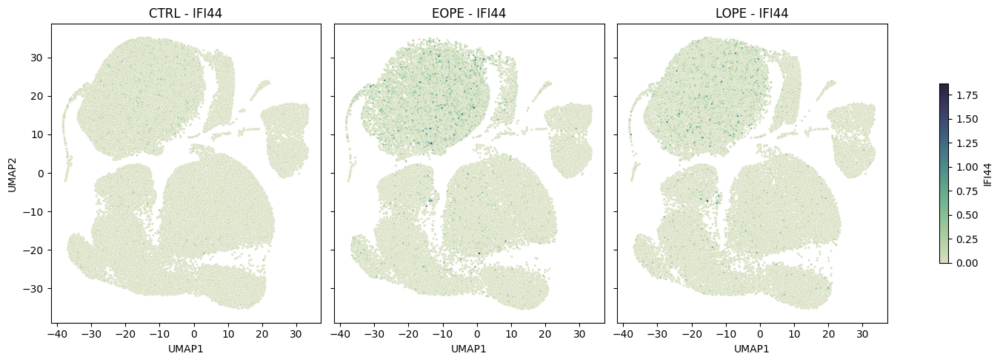

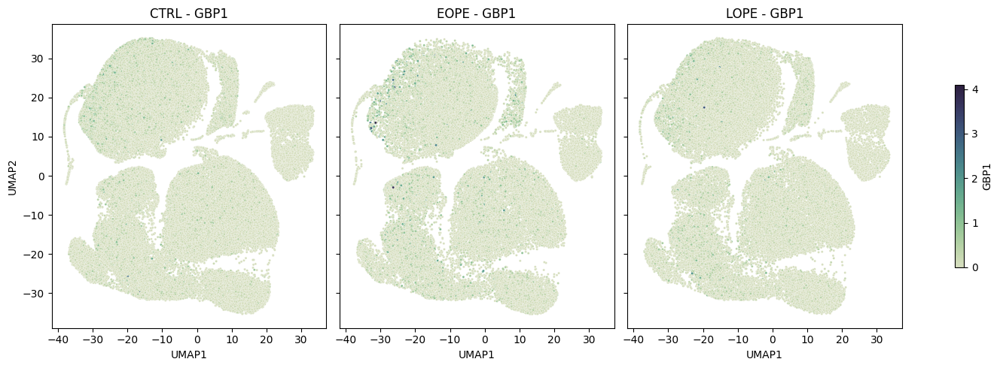

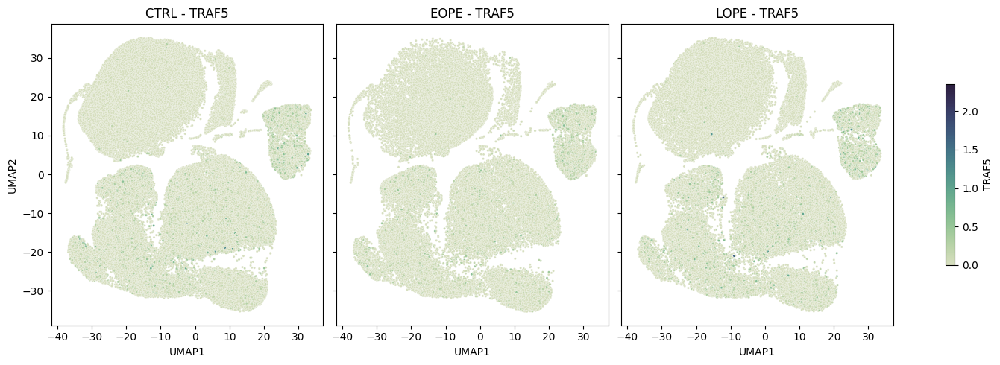

...

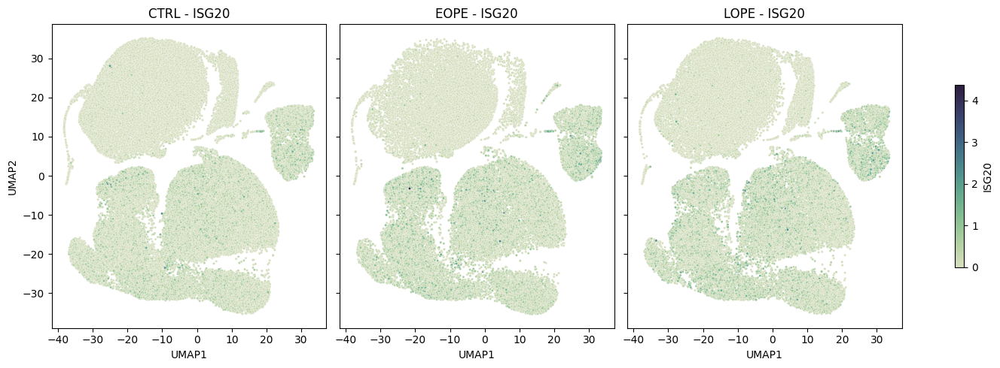

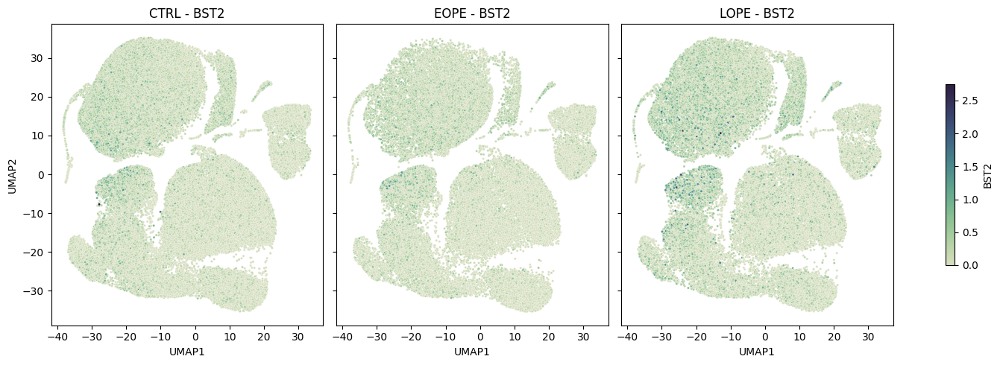

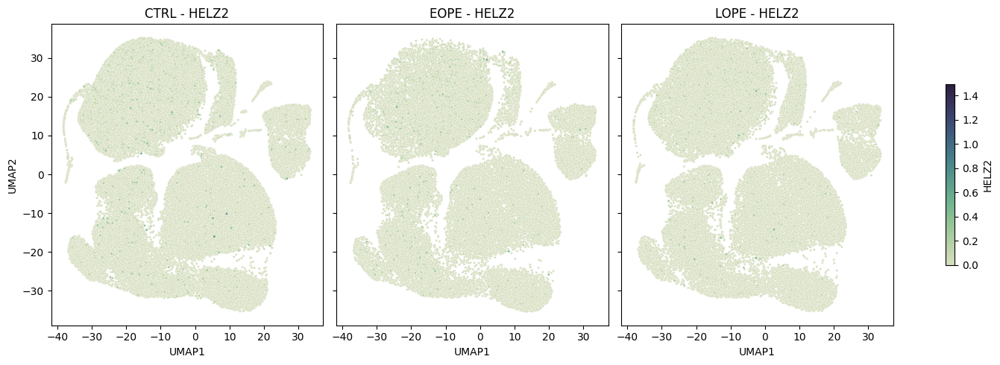

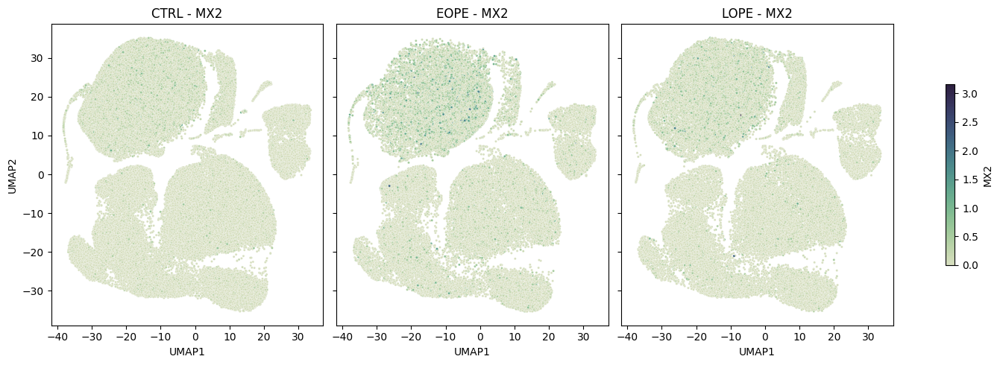

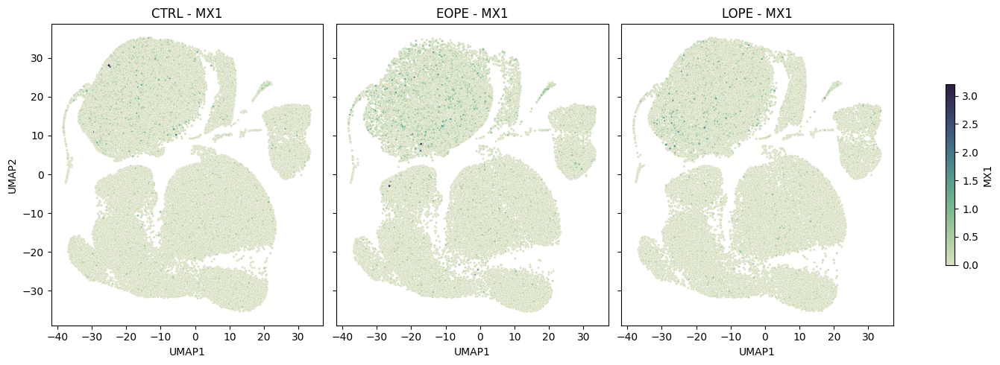

In [31]:
for gene in selected_genes_names:
    plot_marker(ds, gene)